## Object detection API from TensorFlow 2   





### Download essential files

### Install TensorFlow 2 Object Detection API on Colab

In [ ]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 78330, done.
remote: Counting objects: 100% (133/133), done.
remote: Compressing objects: 100% (85/85), done.
remote: Total 78330 (delta 58), reused 117 (delta 48), pack-reused 78197
Receiving objects: 100% (78330/78330), 593.56 MiB | 28.22 MiB/s, done.
Resolving deltas: 100% (55664/55664), done.


In [ ]:
%%bash
cd models/research
# Compile protos.
protoc object_detection/protos/*.proto --python_out=.
# Install TensorFlow Object Detection API.
cp object_detection/packages/tf2/setup.py .
python -m pip install --use-feature=2020-resolver .


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1696507 sha256=8feb86717a084ec83fd370ba380882036dd0e95a19febf653e89ffdb11a48aa8
  Stored in directory: /tmp/pip-ephem-wheel-cache-29ts6npv/wheels/fa/a4/d2/e9a5057e414fd46c8e543d2706cd836d64e1fcd9eccceb2329
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78544 sha256=9a19a9acc11855d2451d5d1564f908dc4d560de92f7830bd765afac5f4b2da8e
  Stored in directory: /root/.cache/pip/wheels/a4/61/fd/c57e374e580aa78a45ed78d5859b3a44436af17e22ca53284f
  Created wheel for avro-python3: filename=avro_python3-1.10.2-py3-none-any.whl size=44010 sha256=ba541e1de70fd7e616452c4ada9339341ea28d6245228c64c3f3dc1b958b7084
  Stored in directory: /root/.cache/pip/wheels/d6/e5/b1/6b151d9b535ee50aaa6ab27d145a0104b6df02e5636f0376da
  Created wheel for docopt: filename=docopt-

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.


In [ ]:
!mkdir unprocessed_data
!unzip "./Alita and Poros.v10i.coco-segmentation.zip" -d ./unprocessed_data

Archive:  drive/MyDrive/Colab Notebooks/Dataset/Alita and Poros.v9i.coco-segmentation.zip
 extracting: /content/unprocessed_data/README.dataset.txt  
 extracting: /content/unprocessed_data/README.roboflow.txt  
   creating: /content/unprocessed_data/test/
 extracting: /content/unprocessed_data/test/02_sm_bmp.rf.af3e38b6650765d0fc8d961c689f62ac.jpg  
 extracting: /content/unprocessed_data/test/05_sm_bmp.rf.3eb5ffd6f55858c6387cc746dde63b43.jpg  
 extracting: /content/unprocessed_data/test/08_sm_bmp.rf.85c4916a9ed31a8a6417a27f510293d8.jpg  
 extracting: /content/unprocessed_data/test/1-1_bmp.rf.5710f73f56b845b53f8f8abc6a61769d.jpg  
 extracting: /content/unprocessed_data/test/10_bmp.rf.4384537c75fe8c89c02690f90848769f.jpg  
 extracting: /content/unprocessed_data/test/10_sm_bmp.rf.40ccd0670dcb7222a6214b6dc450bf5b.jpg  
 extracting: /content/unprocessed_data/test/11-6_bmp.rf.503ac11afa7282bb1c90fdb6a2d961f2.jpg  
 extracting: /content/unprocessed_data/test/12-5_bmp.rf.4645571a0f9b50352a7135

# Dependecies

In [ ]:
!pip install matplotlib_scalebar
!pip install pygad

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 56 kB 4.0 MB/s 


### Download Mask RCNN model

In [ ]:
!wget "http://download.tensorflow.org/models/object_detection/tf2/20200711/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz"

--2022-10-31 11:50:57--  http://download.tensorflow.org/models/object_detection/tf2/20200711/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 142.250.145.128, 2a00:1450:4013:c14::80
Connecting to download.tensorflow.org (download.tensorflow.org)|142.250.145.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 484546405 (462M) [application/x-tar]
Saving to: ‘mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz’

mask_rcnn_inception 100%[===================>] 462.10M   129MB/s    in 3.8s    

2022-10-31 11:51:01 (122 MB/s) - ‘mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz’ saved [484546405/484546405]



In [ ]:
!tar -xzvf mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz

mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/checkpoint/
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/checkpoint/ckpt-0.data-00000-of-00001
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/checkpoint/checkpoint
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/checkpoint/ckpt-0.index
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/pipeline.config
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/saved_model/
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/saved_model/saved_model.pb
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/saved_model/assets/
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/saved_model/variables/
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/saved_model/variables/variables.data-00000-of-00001
mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/saved_model/variables/variables.index


### install right OpenCV version

In [ ]:
!pip install opencv-python-headless==4.5.5.62

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 47.7 MB 1.3 MB/s 
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.5.2.52
    Uninstalling opencv-python-headless-4.5.2.52:
      Successfully uninstalled opencv-python-headless-4.5.2.52
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-models-official 2.10.0 requires opencv-python-headless==4.5.2.52, but you have opencv-python-headless 4.5.5.62 which is incompatible.


In [ ]:
import cv2 as cv
import matplotlib
import matplotlib.pyplot as plt
import os
import random
import pygad
import json
import io
import imageio
import glob
import scipy.misc
import subprocess
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf
from google.colab import files
import pathlib
import itertools
import random
from IPython.display import Javascript

from analysis_components.size_measure import *
from metrics.calculate_metrics import *
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

from object_detection.utils import config_util
from object_detection.utils import colab_utils
from object_detection.builders import model_builder
%matplotlib inline

### Install right version of libcudnn8

In [ ]:
!apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following packages will be REMOVED:
  libcudnn8-dev
The following held packages will be changed:
  libcudnn8
The following packages will be DOWNGRADED:
  libcudnn8
0 upgraded, 0 newly installed, 1 downgraded, 1 to remove and 27 not upgraded.
Need to get 430 MB of archives.
After this operation, 1,392 MB disk space will be freed.
Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  libcudnn8 8.1.0.77-1+cuda11.2 [430 MB]
Fetched 430 MB in 8s (56.3 MB/s)
(Reading database ... 123942 files and directories currently installed.)
Removing libcudnn8-dev (8.1.1.33-1+cuda11.2) ...
update-alternatives: removing manually selected alternative - switching libcudnn to auto mode
dpkg: warning: downgrading libcudnn8 from 8.1.1.33-1+cuda11.2 to

In [ ]:
from preprocess.img_preprocessing import preprocess_dataset

preprocess_dataset((2, 52, 84), 'unprocessed_data')

Preprocessing dataset
Directories created


In [ ]:
from train import *

#!mkdir 'maskrcnn/data/tf_records'
convert_data_to_tfrecords(
    include_masks=True,
    train_image_dir='maskrcnn/data/train',
    test_image_dir='maskrcnn/data/valid',
    train_annotations_file='maskrcnn/data/train/_annotations.coco.json',
    test_annotations_file='maskrcnn/data/valid/_annotations.coco.json',
    output_dir='maskrcnn/data/tf_records'
)

Found groundtruth annotations. Building annotations index.
%d images are missing annotations. 0
On image %d of %d 0 220
On image %d of %d 100 220
On image %d of %d 200 220
Finished writing, skipped %d annotations. 57
Found groundtruth annotations. Building annotations index.
%d images are missing annotations. 0
On image %d of %d 0 56
Finished writing, skipped %d annotations. 19


In [ ]:
train_model(
    pipeline_config_path='configs/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8-colab.config',
    model_dir='training'
)

Instructions for updating:
rename to distribute_datasets_from_function
Instructions for updating:
Use `tf.data.Dataset.interleave(map_func, cycle_length, block_length, num_parallel_calls=tf.data.AUTOTUNE)` instead. If sloppy execution is desired, use `tf.data.Options.deterministic`.
Instructions for updating:
Use `tf.data.Dataset.map()
Instructions for updating:
Use fn_output_signature instead
Instructions for updating:
Create a `tf.sparse.SparseTensor` and use `tf.sparse.to_dense` instead.
Instructions for updating:
Use `tf.cast` instead.
/usr/local/lib/python3.7/dist-packages/keras/backend.py:452: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  "`tf.keras.backend.set_learning_phase` is deprecated and "
Instructions for updating:
box_ind is deprecated, use box_indices instead
Instructions for updating:
Use ref

In [ ]:
conversion(
    pipeline_config_path='configs/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8-colab.config',
    trained_checkpoint_dir='training/',
    output_directory='finetuned-maskrcnn'
)

Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))


In [ ]:
!zip -r ./training.zip ./training
!zip -r ./finetuned-maskrcnn.zip ./finetuned-maskrcnn

  adding: training/ (stored 0%)
  adding: training/train/ (stored 0%)
  adding: training/train/events.out.tfevents.1663094099.f256cf7ee197.624.0.v2 (deflated 6%)
  adding: training/ckpt-2.index (deflated 83%)
  adding: training/ckpt-1.data-00000-of-00001 (deflated 7%)
  adding: training/ckpt-2.data-00000-of-00001 (deflated 8%)
  adding: training/checkpoint (deflated 55%)
  adding: training/ckpt-1.index (deflated 81%)
  adding: finetuned-maskrcnn/ (stored 0%)
  adding: finetuned-maskrcnn/saved_model/ (stored 0%)
  adding: finetuned-maskrcnn/saved_model/assets/ (stored 0%)
  adding: finetuned-maskrcnn/saved_model/saved_model.pb (deflated 92%)
  adding: finetuned-maskrcnn/saved_model/variables/ (stored 0%)
  adding: finetuned-maskrcnn/saved_model/variables/variables.index (deflated 81%)
  adding: finetuned-maskrcnn/saved_model/variables/variables.data-00000-of-00001 (deflated 7%)
  adding: finetuned-maskrcnn/pipeline.config (deflated 70%)
  adding: finetuned-maskrcnn/checkpoint/ (stored 0

In [ ]:
category_index, label_map_dict, masking_model = get_inference_model(
    'training/',
    'configs/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8-colab.config',
    'finetuned-maskrcnn/saved_model',
    'maskrcnn/data/labelmap.pbtxt'
)

In [ ]:
!mkdir results2

Calculating metrics...
Running inference for :  maskrcnn/data/test/02_sm_bmp.rf.af3e38b6650765d0fc8d961c689f62ac.jpg


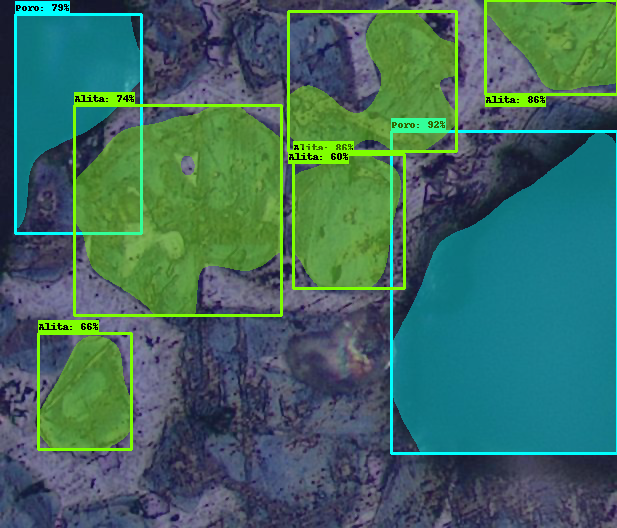

/content/metrics/calculate_metrics.py:119: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  masks_predicted = np.array(masks_predicted)


Metrics:  [0.4053611208277335, 0, 0.9577432876401949, 0, 4.747993048084085, 0, 0.9731539175394406, 0, 0.3873137612371912, 0, 2.2540022690028994, 0, 1.4155797876131424, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/05_sm_bmp.rf.3eb5ffd6f55858c6387cc746dde63b43.jpg


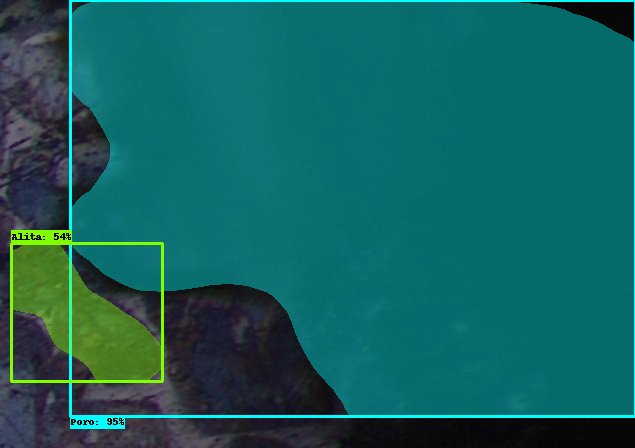

Metrics:  [1.0081042916939835, 0, 1.780063148398737, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/08_sm_bmp.rf.85c4916a9ed31a8a6417a27f510293d8.jpg


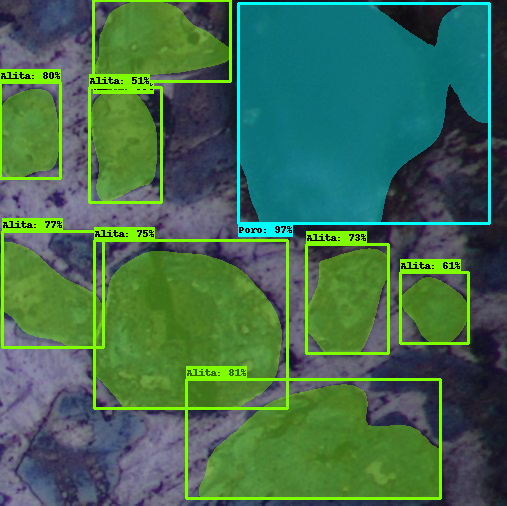

Metrics:  [0.9470692472326422, 0, 0.31535290569072993, 0, 1.0214114048503387, 0, 0.6182136602451839, 0, 0.20401678412840674, 0, 0.33524666459820046, 0, 0.23370136698212407, 0, 2.0089030206677267, 0, 4.449368155012637, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/1-1_bmp.rf.5710f73f56b845b53f8f8abc6a61769d.jpg


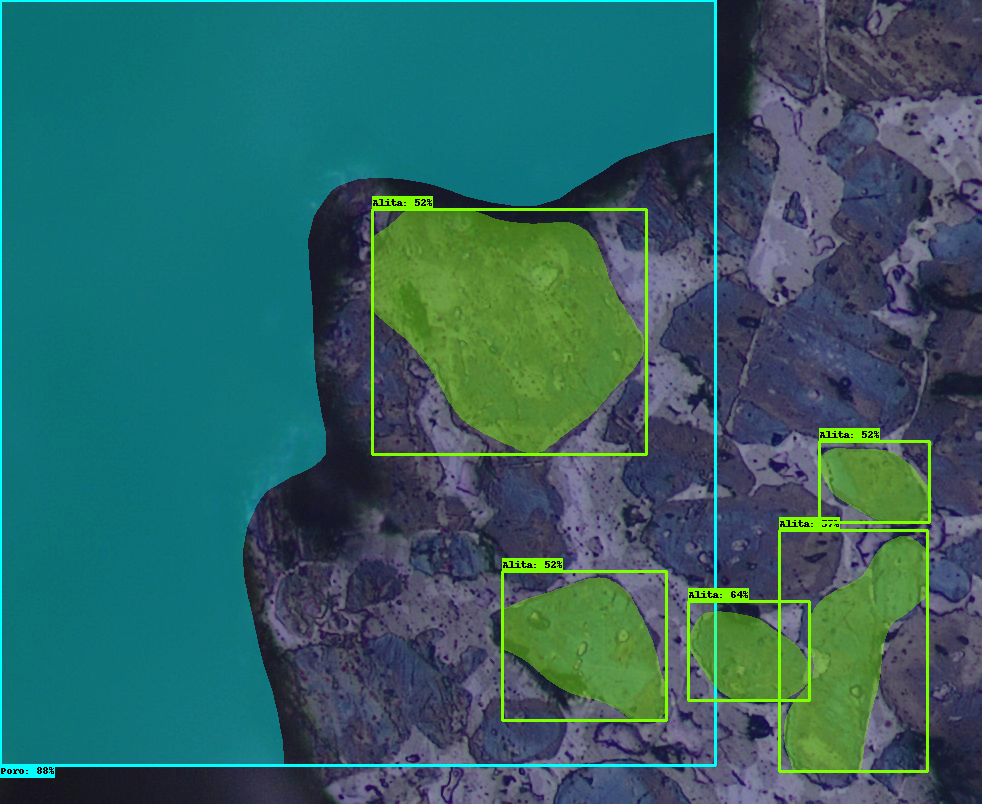

Metrics:  [1.054675692324264, 0, 1.07080870330776, 0, 0.32552545673214595, 0, 0.3436808538331381, 0, 0.9861676159479251, 0, 0.4679080910377872, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/10_bmp.rf.4384537c75fe8c89c02690f90848769f.jpg


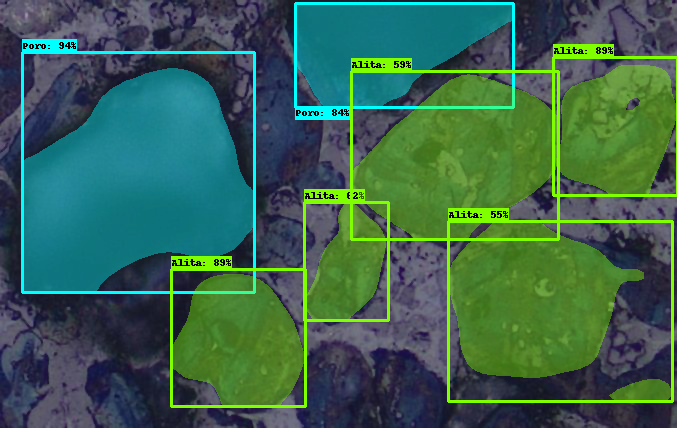

Metrics:  [1.032899542761289, 0, 1.0897485195724064, 0, 0.38803768947152806, 0, 0.15739921647921143, 0, 1.0782196039927998, 0, 0.9954331997759683, 0, 0.5883527897376715, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/10_sm_bmp.rf.40ccd0670dcb7222a6214b6dc450bf5b.jpg


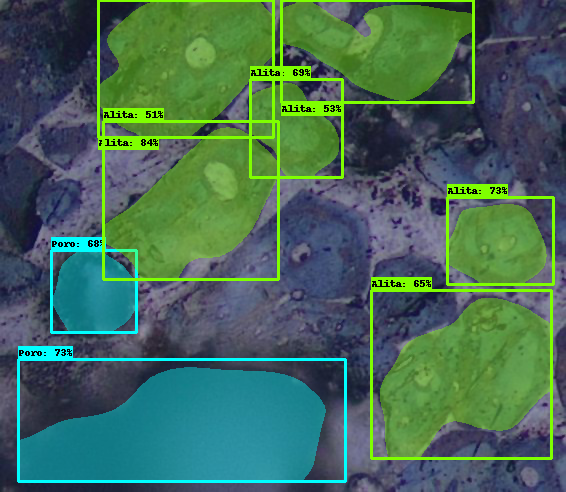

Metrics:  [0.28076943976525565, 0, 1.342554619342331, 0, 0.9215595623362614, 0, 0.35456625021995425, 0, 0.4438212411796635, 0, 0.07699847527771728, 0, 0.04411396106608739, 0, 1.0539910662264518, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/11-6_bmp.rf.503ac11afa7282bb1c90fdb6a2d961f2.jpg


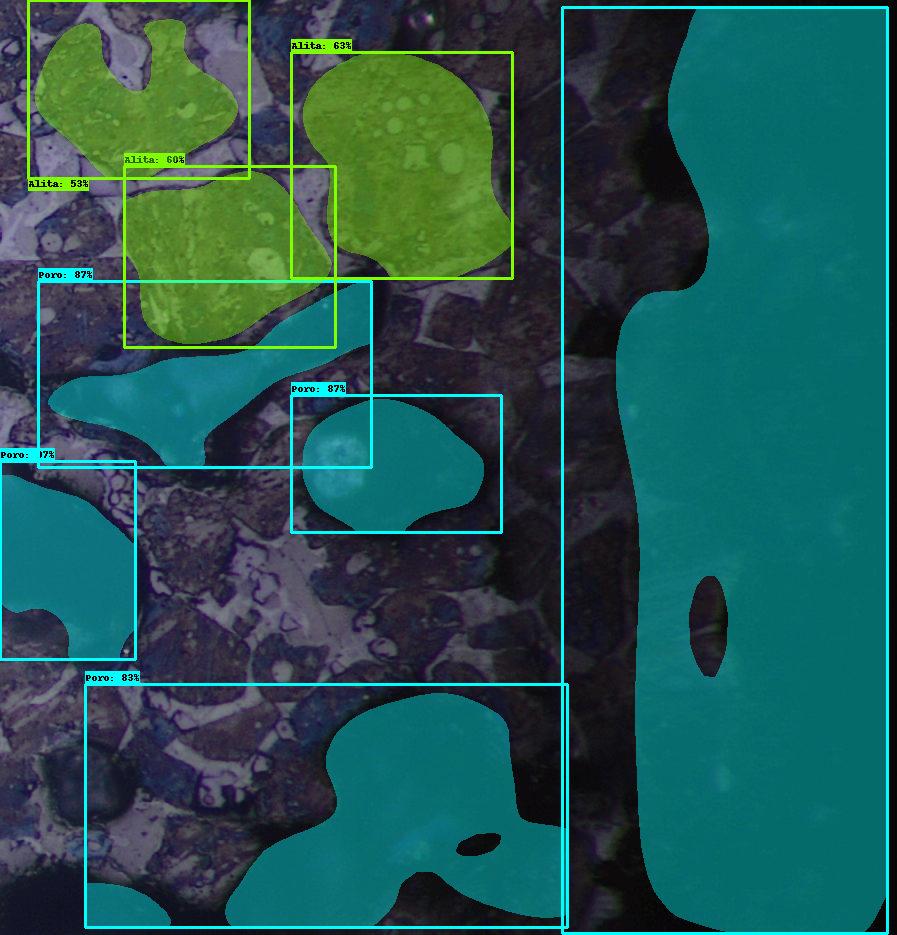

Metrics:  [1.051444640494045, 0, 0.003321264512990354, 0, 1.0980747235989325, 0, 0.9380768585333109, 0, 0.037654284764196154, 0, 0.1803171535750824, 0, 2.017555469054107, 0, 10.191978528384059, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/12-5_bmp.rf.4645571a0f9b50352a7135adf98ac8a0.jpg


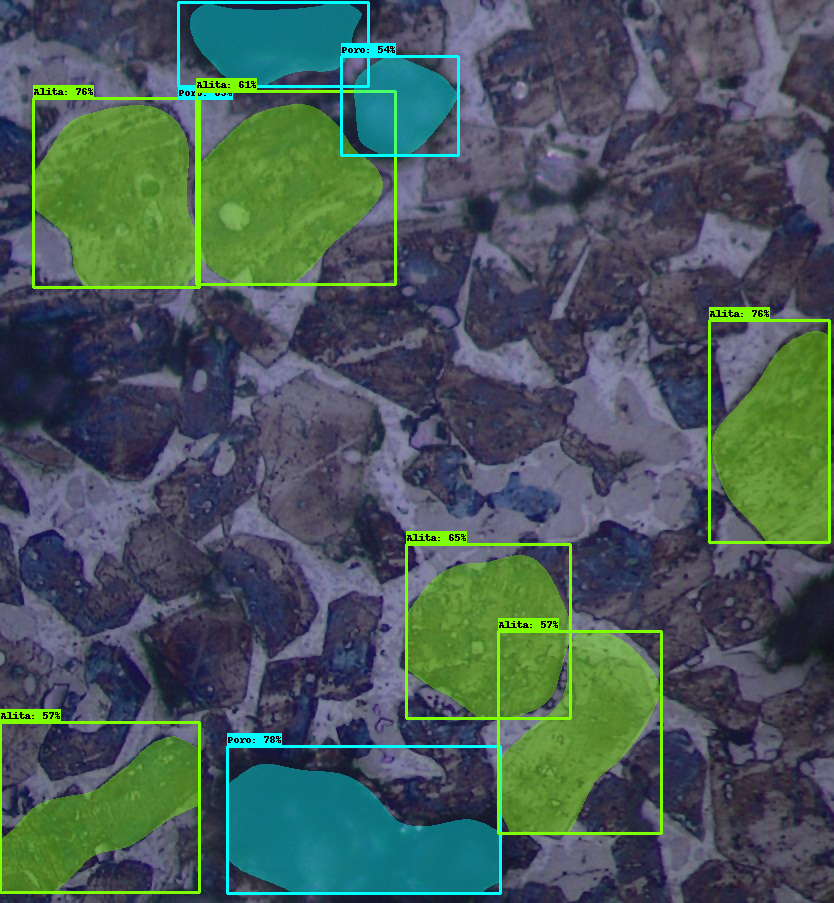

Metrics:  [0.44469164715066356, 0, 0.4671077814841144, 0, 0.27704374816492594, 0, 2.7048408363156904, 0, 0.17604017216642753, 0, 0.33251853662511205, 0, 0.432970720355036, 0, 0.7257802868081241, 0, 0.6388225934765315, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/12_sm_bmp.rf.467e3f28dcf7e8c27ea354b7bd87f13b.jpg


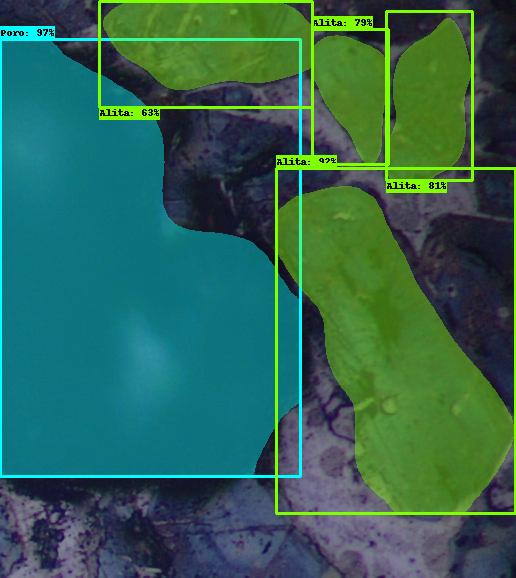

Metrics:  [1.0956704706821314, 0, 0.17272595246163527, 0, 0.0766223612197029, 0, 1.6594602882551364, 0, 2.7601976099873156, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/13_bmp.rf.d99e06f89374a9c84a9771fa56ecc3df.jpg


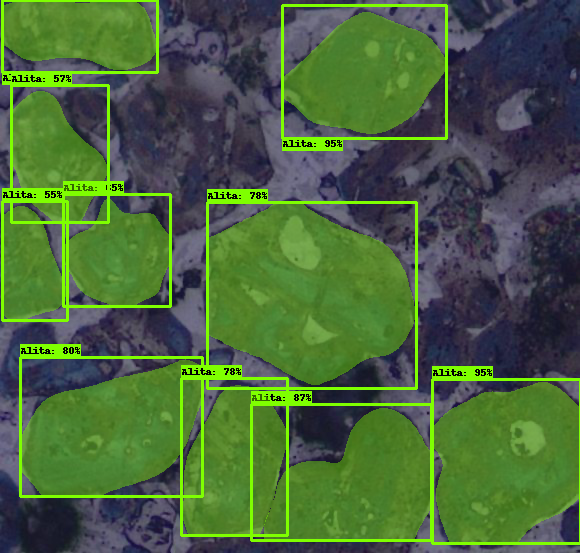

Metrics:  [0.7173544375353307, 0, 0.349025974025974, 0, 0.18351286847706896, 0, 0.6701517131655208, 0, 0.029772645254420787, 0, 0.7191831991367146, 0, 2.2614638995899092, 0, 2.2116928644125298, 0, 1.0805991440798859, 0, 3.1796461790990334, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/13_sm_bmp.rf.3401eec5dffc81839f767fb7f65f9102.jpg


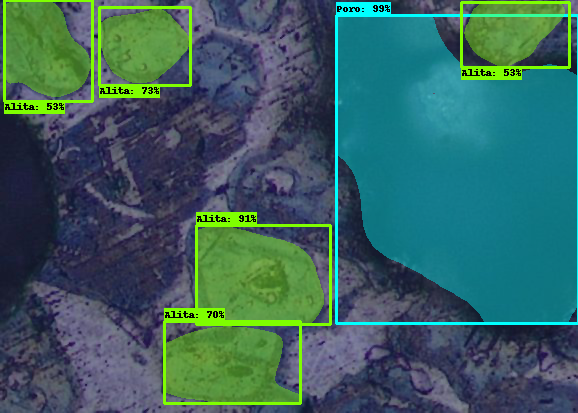

Metrics:  [1.0428875772709811, 0, 0.8413110342176087, 0, 2.5103113627173474, 0, 0.7282973621103117, 0, 1.882225119513255, 0, 4.706242158092848, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/13_sm_bmp.rf.5e9b4130d034154c56062982726a2508.jpg


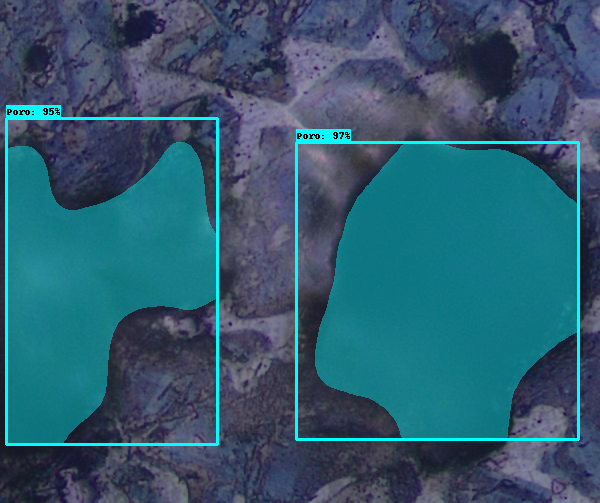

Metrics:  [0.04892613408269771, 0, 1.591549645214112, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/13_sm_bmp.rf.7afa428db272db89cf49c9936831e370.jpg


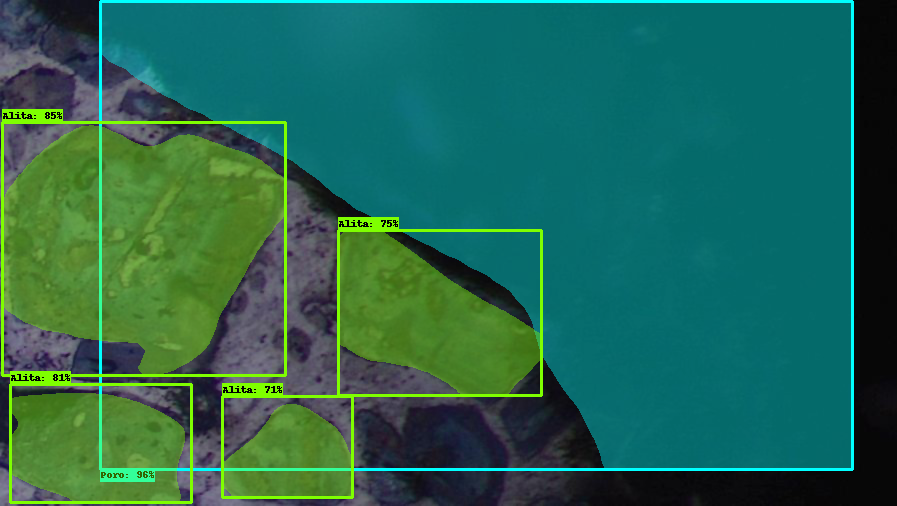

Metrics:  [0.010751862029069347, 0, 4.956909420217742, 0, 0.5982625599902801, 0, 0.19965092601570833, 0, 0.23486921308963554, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/15_bmp.rf.d0e0e4f2e9e05cdb01e3d52d0234eec6.jpg


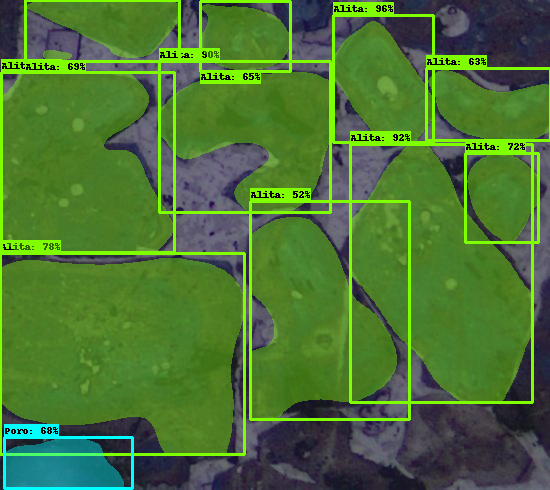

Metrics:  [1.060758855414093, 0, 0.1889135562647426, 0, 0.34405482158291145, 0, 0.7653791851553046, 0, 0.057735996866431646, 0, 0.18500969200947665, 0, 0.1487476571818027, 0, 0.09288497026860774, 0, 3.691079412390888, 0, 3.5817356205852673, 0, 2.295863309352518, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/16_bmp.rf.842f5a9ee29eabd0060044a7d7c96dd6.jpg


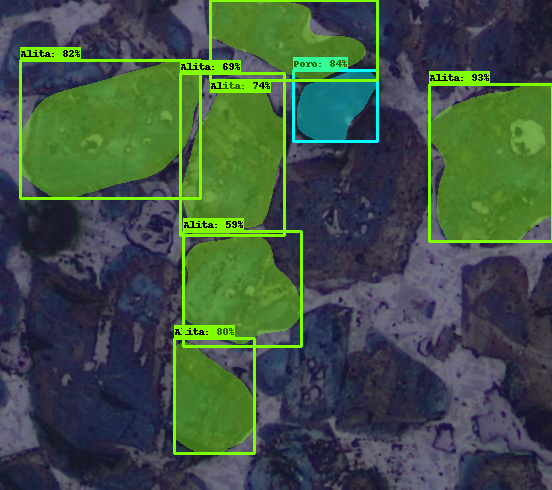

Metrics:  [0.16618363445766787, 0, 4.635698056046453, 0, 0.673594412000458, 0, 0.9958052434456929, 0, 0.2230769230769231, 0, 0.3794003705575206, 0, 0.7257178397429253, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/18_sm_bmp.rf.d42e3083f2ee3eda3672f66dbb580096.jpg


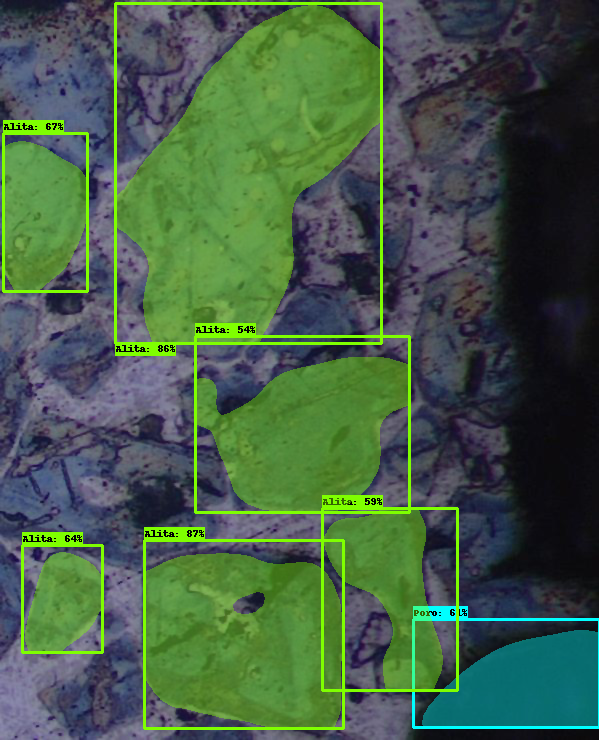

Metrics:  [1.4785511269746843, 0, 0.2587510763355921, 0, 0.12644466209598432, 0, 0.1928484638083666, 0, 0.4540615598241148, 0, 0.5845858383433534, 0, 0.03830214195349649, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/18_sm_bmp.rf.f81ea0e331d2ec54776b4c2ace6499fe.jpg


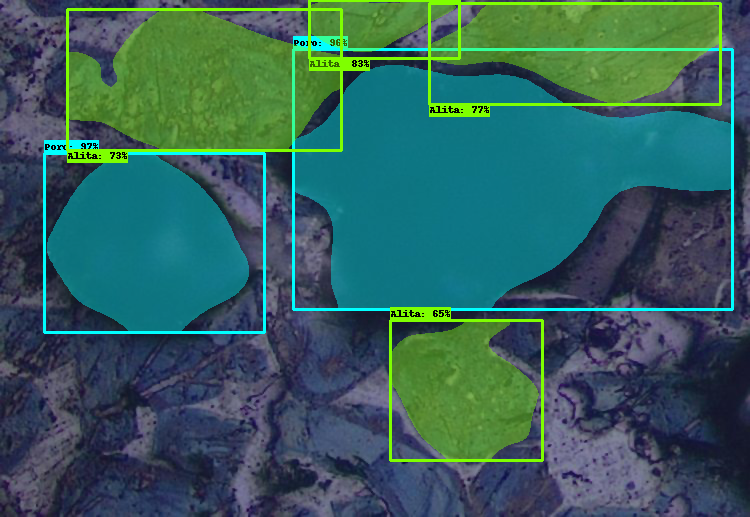

Metrics:  [1.0452597223860642, 0, 1.0880232339724603, 0, 0.6317567567567568, 0, 0.7463168516649848, 0, 0.34010262340102626, 0, 0.9446479446479447, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/19_sm_bmp.rf.948a1ed390ff741b8a0857805d7953d0.jpg


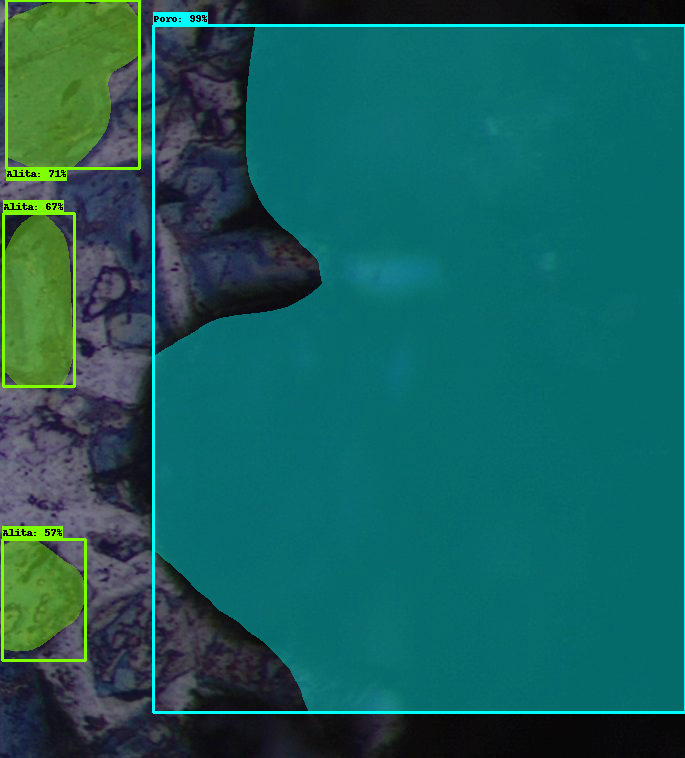

Metrics:  [1.0970288057237554, 0, 0.06107086257640933, 0, 1.0338022849589275, 0, 0.5243716150534647, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/19_sm_bmp.rf.a9c272f807438f8c0490b6d75ed5db9d.jpg


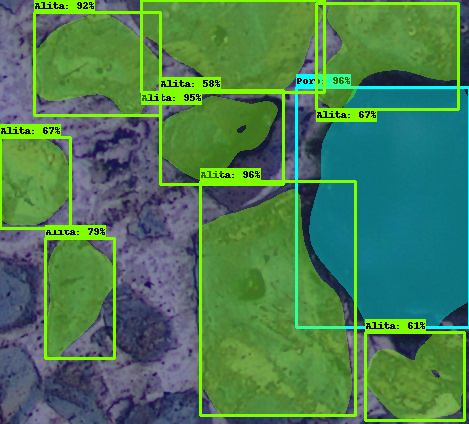

Metrics:  [0.08616939807014856, 0, 1.3020752413716568, 0, 0.44169062232926737, 0, 3.412045782864763, 0, 1.677367860943597, 0, 0.7195325542570952, 0, 0.5922368163105274, 0, 0.8051665110488639, 0, 0.5744648318042813, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/1_1_bmp.rf.bf12b8bda2dfd61c8a53c861447a9f02.jpg


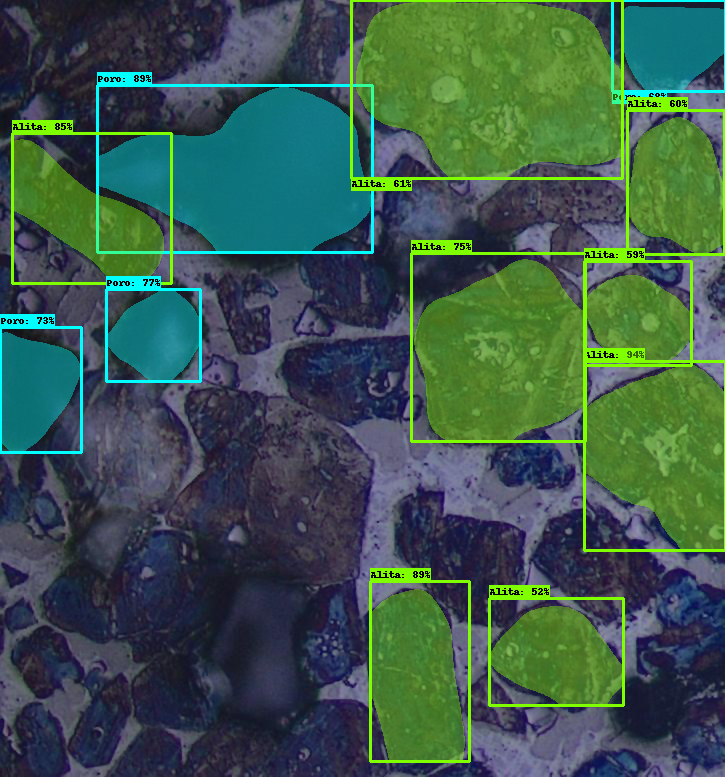

Metrics:  [1.555202460276781, 0, 0.24665481739830308, 0, 0.9939948956613122, 0, 1.0642218741361835, 0, 1.030982201713909, 0, 0.2794893825948202, 0, 1.3416714042069358, 0, 0.517910447761194, 0, 0.39616362254657894, 0, 0.40982483608963693, 0, 3.742376155650614, 0, 0.4177691728514575, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/1_5_bmp.rf.aed3471cd3b0fe9d2c427c2b820a2c95.jpg


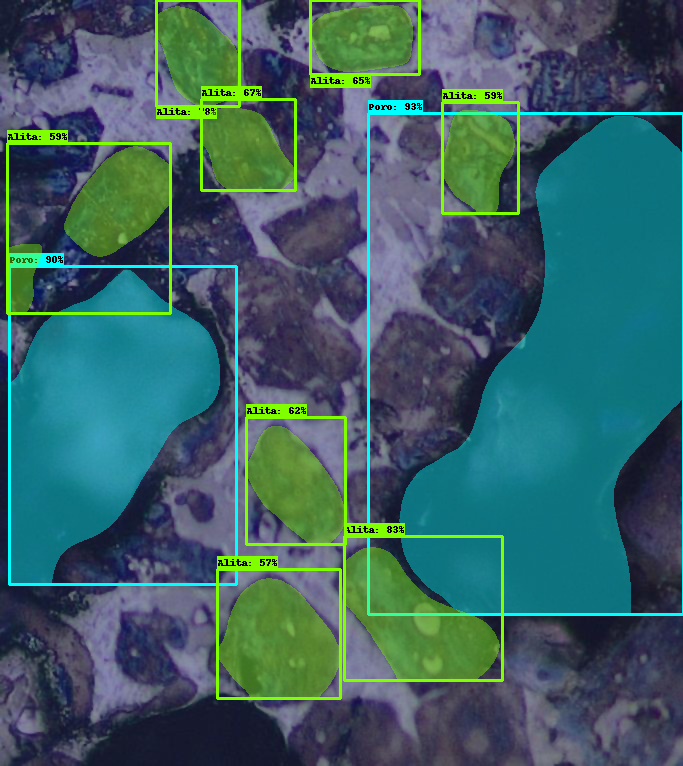

Metrics:  [0.12114034143248513, 0, 2.313257762444554, 0, 4.011606848864011, 0, 0.9390018484288355, 0, 1.0692520775623269, 0, 1.0889200070015754, 0, 1.5397256553035448, 0, 0.056120875732346594, 0, 2.5614098183779896, 0, 0.15460224141098658, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/2-3_bmp.rf.7af26fc2d038f7967affb6d7ca2c1b4b.jpg


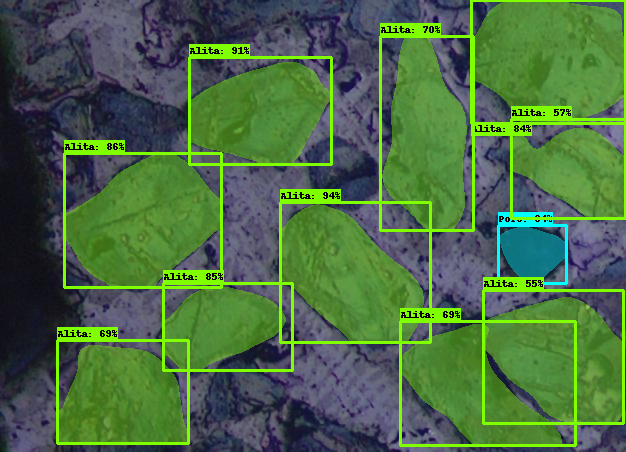

Metrics:  [0.685171102661597, 0, 0.26223908918406075, 0, 1.0523806184699531, 0, 1.5032376126126126, 0, 1.574052812858783, 0, 0.8677919307272385, 0, 0.6063548854246529, 0, 0.4714773281326182, 0, 1.1859209257473482, 0, 1.4728132387706856, 0, 1.1417824518308128, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/25_sm_bmp.rf.99b914a3c8f9de9d01c6e6160bdda596.jpg


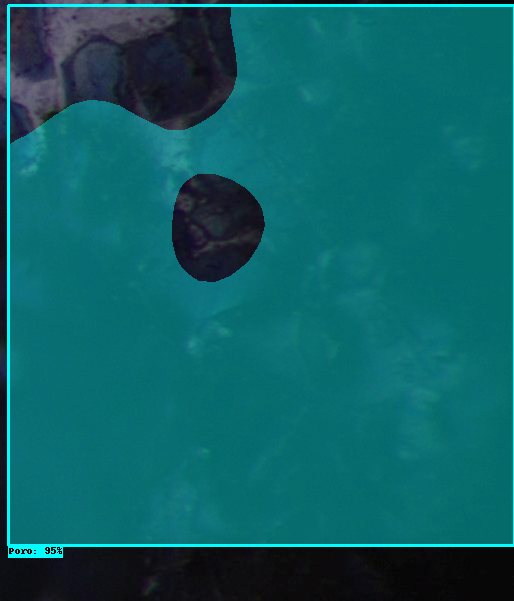

Metrics:  [0.023257853179060418, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/2_5_bmp.rf.56b425d5e97a4e5fcd01b956c5c14bd1.jpg


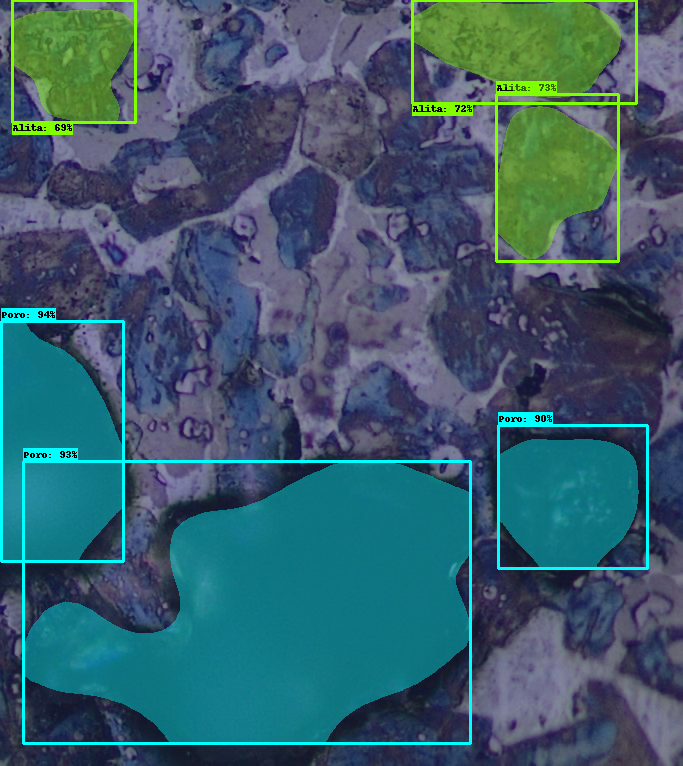

Metrics:  [1.1546061183811422, 0, 0.2117832615094199, 0, 5.5573759833560885, 0, 0.39716535433070865, 0, 0.9531363127756204, 0, 0.5091334894613583, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/3-1_bmp.rf.523a775a3fb41ae095b4bbb7c452b77b.jpg


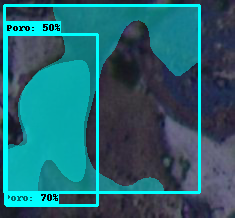

/content/metrics/calculate_metrics.py:118: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  masks_validated = np.array(masks_validated)


Metrics:  [0.33385589037914415, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/3_3_bmp.rf.657e451d39bc4e8721a9f74096b0ead1.jpg


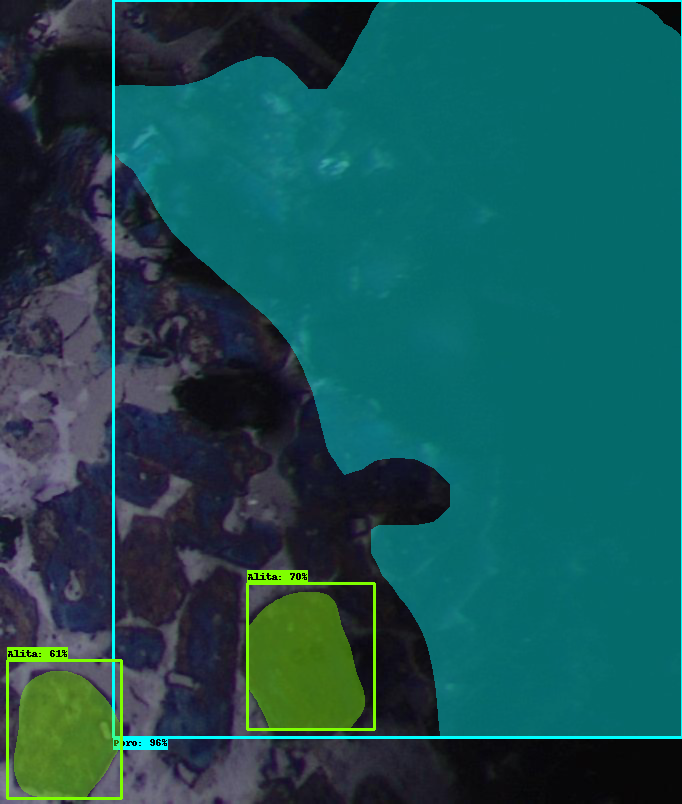

Metrics:  [0.01882270309801636, 0, 17.969673645320196, 0, 0.44658767337191146, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/4-1_bmp.rf.6e50ebc54ff76e9b94bac5285c25d100.jpg


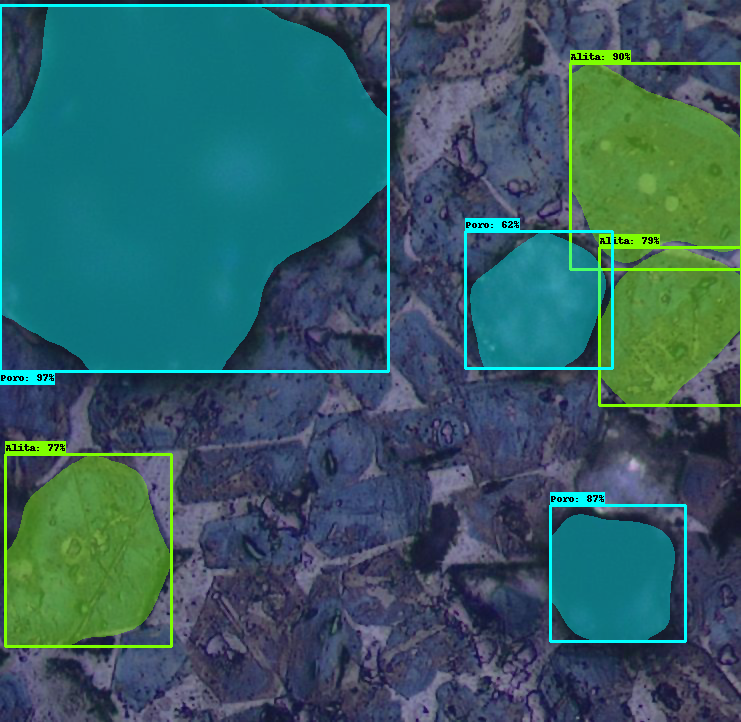

Metrics:  [0.9638280001083805, 0, 0.5285664753245752, 0, 1.0775474064782704, 0, 0.3100681667370453, 0, 0.33358070500927645, 0, 0.1501015619527912, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/5-4_bmp.rf.170c03af3147d30e5e9614940cf2a3cf.jpg


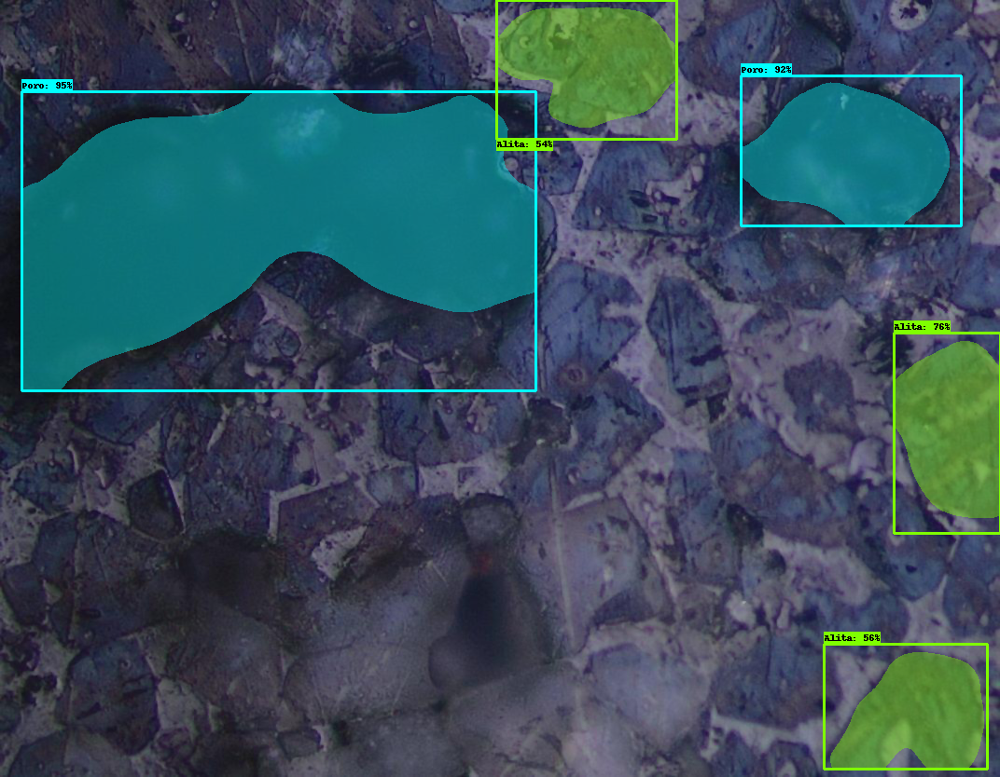

Metrics:  [0.21208114805053804, 0, 4.346771229016052, 0, 0.3793772099920155, 0, 0.5495292401538258, 0, 0.2985455334852925, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/6-4_bmp.rf.178f31723774a0716e35c90c2a5dc59c.jpg


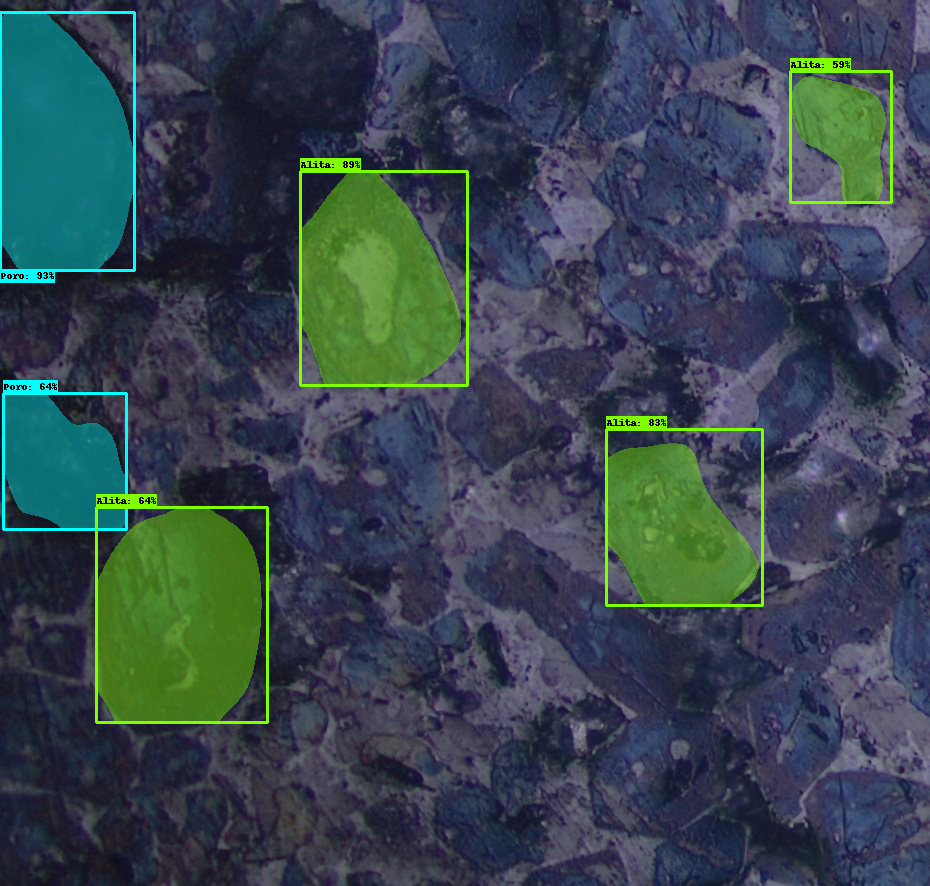

Metrics:  [0.9616106822449405, 0, 1.054661519055082, 0, 0.6720864190656496, 0, 0.2691202733131454, 0, 0.1443093417009871, 0, 0.24370379651672722, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/7_6_bmp.rf.10f513768a42ffcb046d2e7ebfcbdbcb.jpg


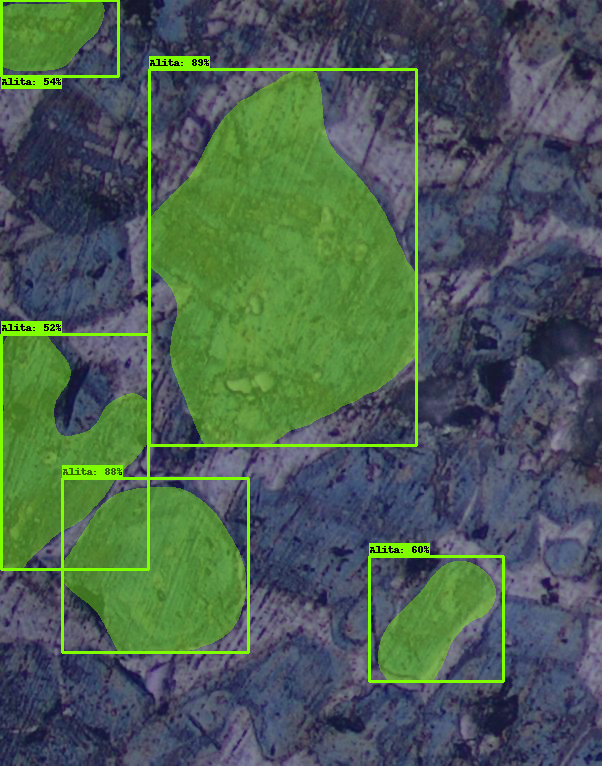

Metrics:  [0.0001764783740459138, 0, 0.9979982593559618, 0, 0.3101970865467009, 0, 11.864721030042919, 0, 0.5031567250871256, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/8-2_bmp.rf.84676b7486a4982508eb69a6a67be561.jpg


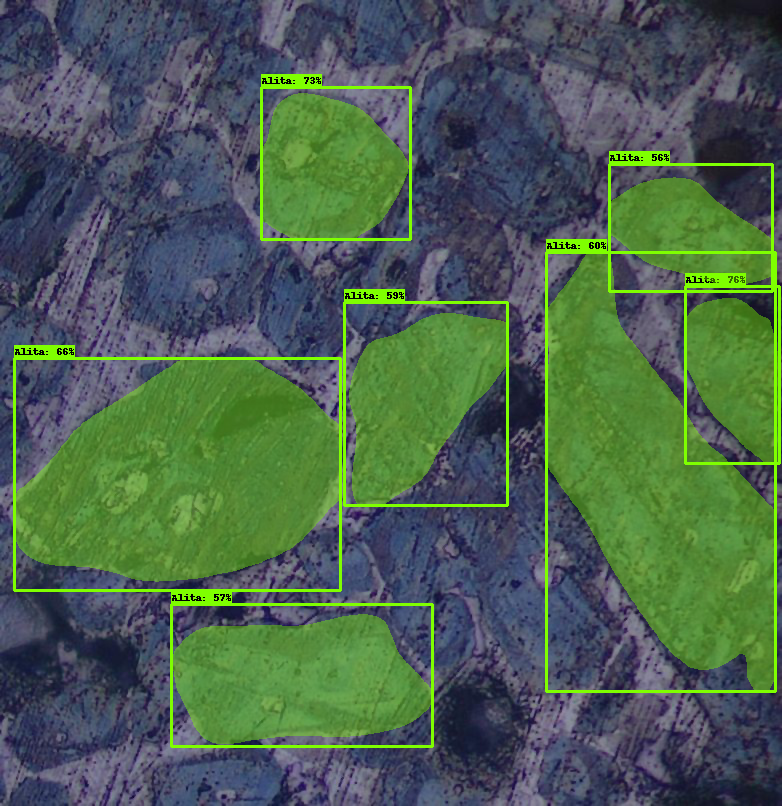

Metrics:  [0.6502423975319525, 0, 0.1680169073617471, 0, 0.040002981125747614, 0, 0.056484536659023546, 0, 0.2228802834725386, 0, 0.5871872485535844, 0, 0.9046903688866633, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/splited_3_parts_00_bmp.rf.77ff1cf5de04cb57c4ffdfee504263fe.jpg


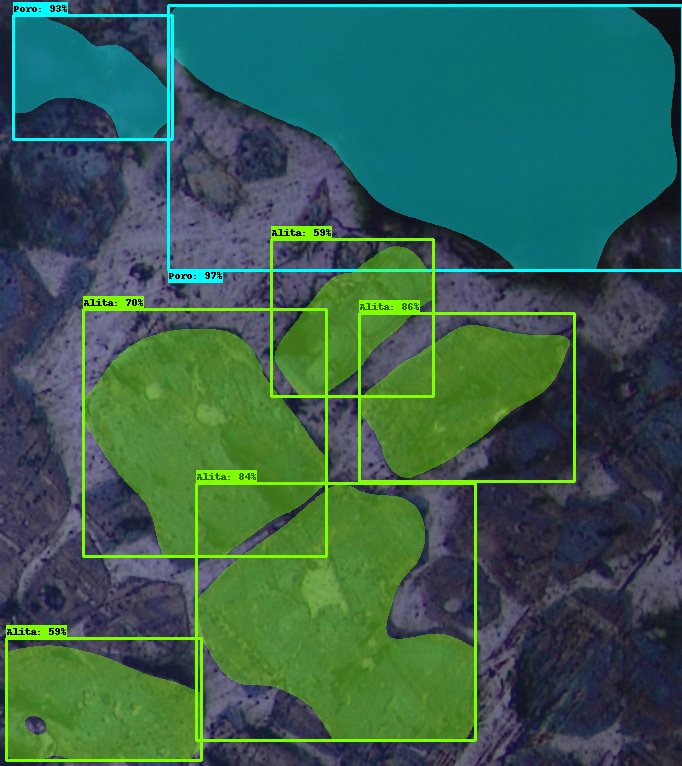

Metrics:  [1.0158667715709415, 0, 0.05538015189009301, 0, 0.029902304744427052, 0, 0.010454955648977615, 0, 0.1369076500080867, 0, 0.6270655493773983, 0, 0.1316905567187416, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/splited_3_parts_20_bmp.rf.b4f9c6ba4c3058d9b7a40f3f4e9e3b22.jpg


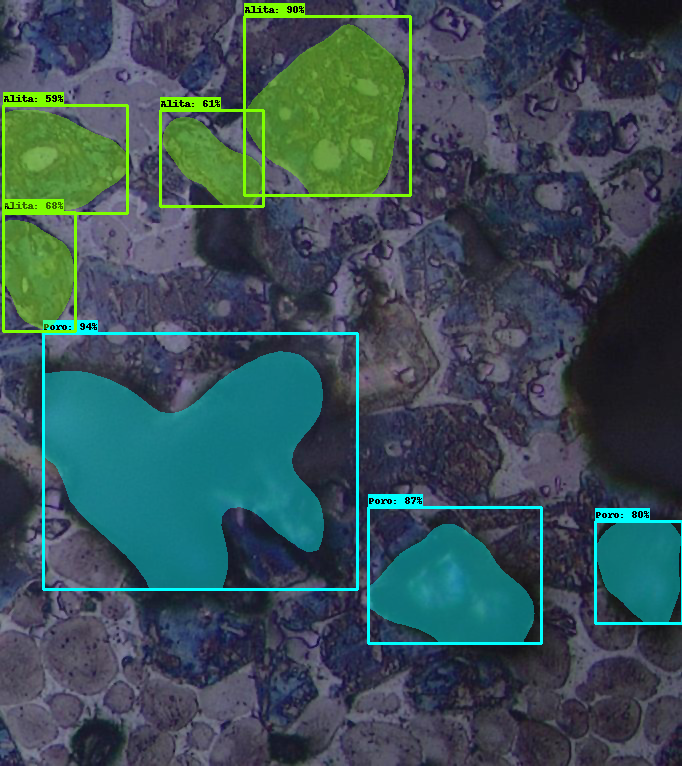

Metrics:  [1.0001352996888107, 0, 0.5445004198152813, 0, 0.07416841474378184, 0, 0.4711066165848021, 0, 0.18802539028992965, 0, 0.4497589199614272, 0, 1.9320024321037697, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/splited_3_parts_22_bmp.rf.121b356c9c6e9e602937a1c53db485e4.jpg


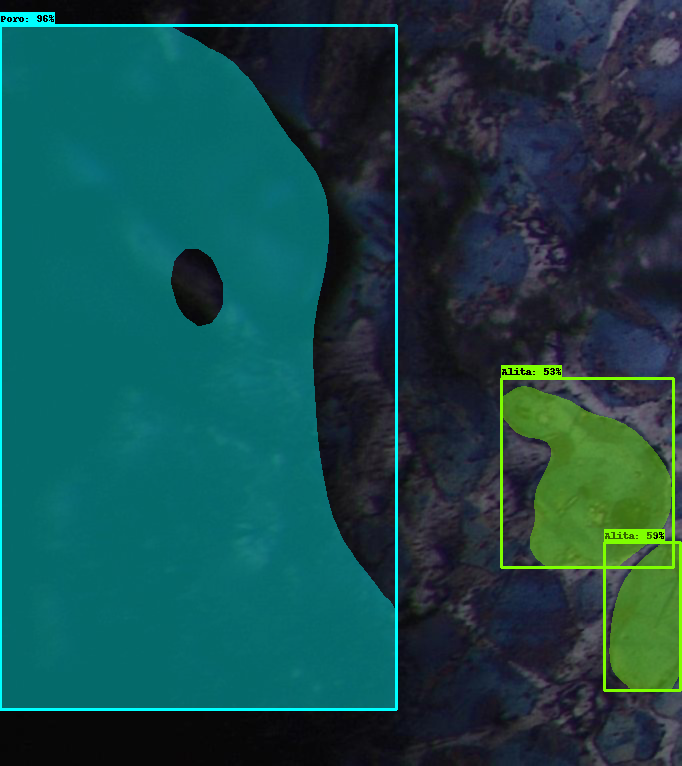

Metrics:  [0.8241240355566151, 0, 0.29685857760130796, 0, 0.10976594027441484, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/splited_3_parts_22_bmp.rf.668638a57baa6e12fa2d5841c15bd226.jpg


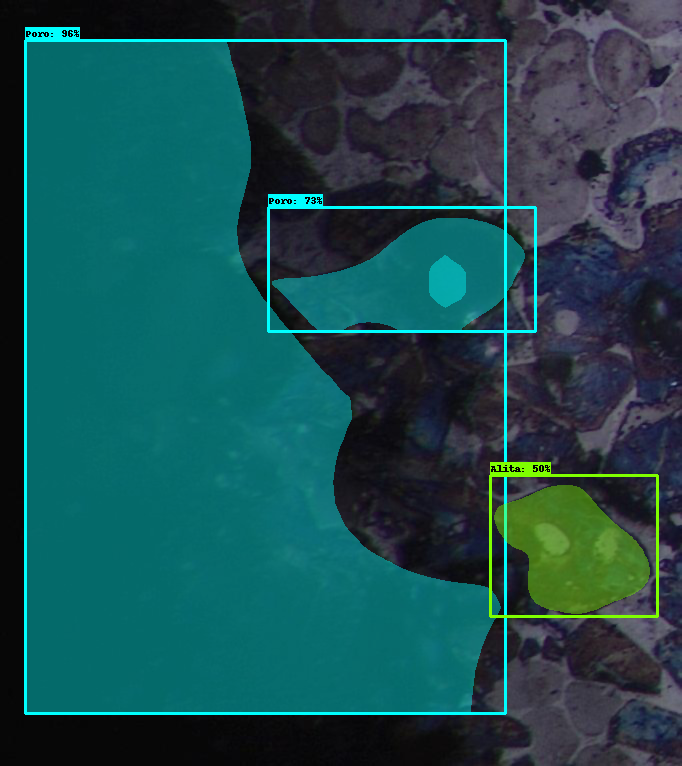

Metrics:  [0.0571215714153548, 0, 0.15423214778053487, 0, 17.01646592468364, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/splited_3_parts_51_bmp.rf.7099242928461355d3a3031f119f279a.jpg


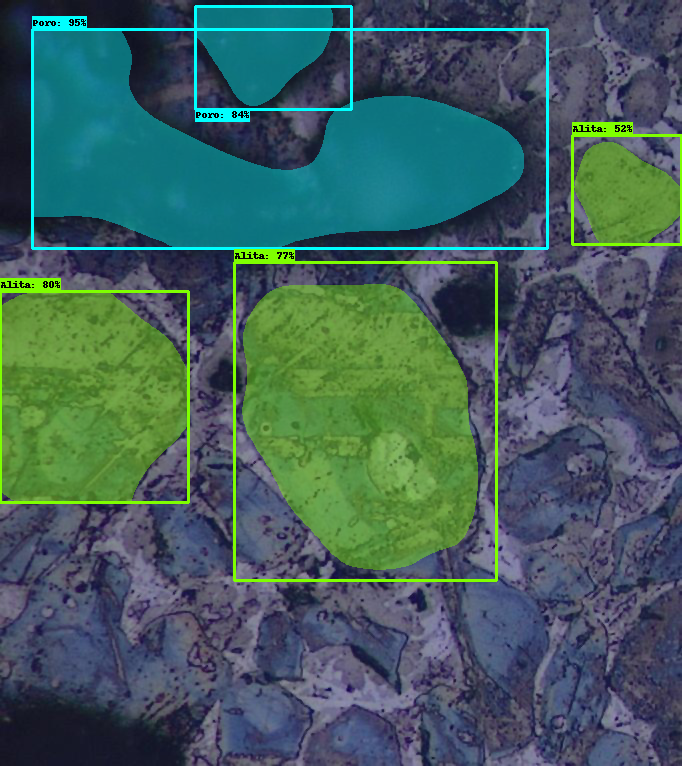

Metrics:  [1.2167934810115903, 0, 1.246087595840773, 0, 0.33005905396714025, 0, 0.017157369955789672, 0, 0.4283397779718099, 0, 0, 0, 0, 0, 0, 0]
Calculating metrics...
Running inference for :  maskrcnn/data/test/splited_3_parts_81_bmp.rf.31808c2b8ee50f4bb366769ba1c377ee.jpg


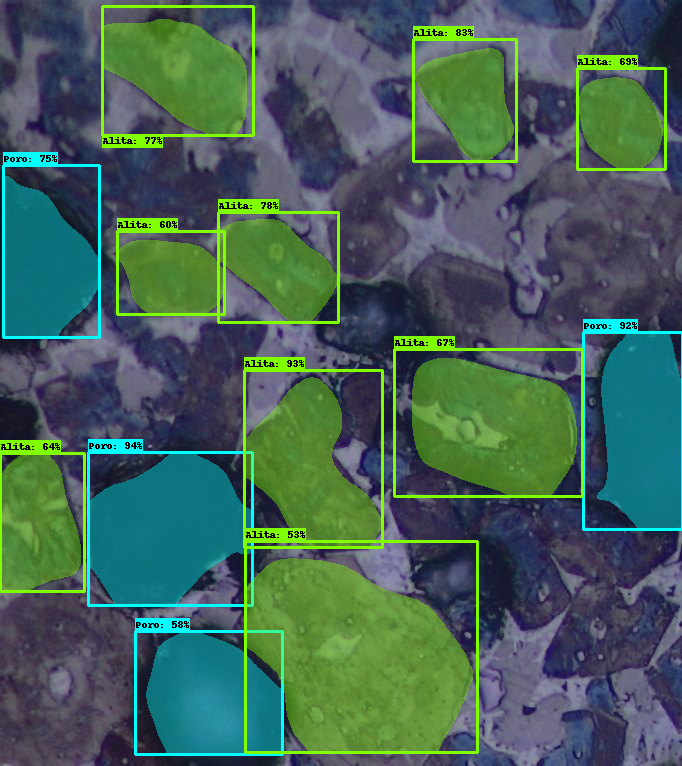

Metrics:  [0.7903581267217631, 0, 1.3794730347680917, 0, 0.637666690437139, 0, 0.1389261744966443, 0, 1.6861722427172114, 0, 0.2775816036517096, 0, 0.42815482502651114, 0, 1.17753143613501, 0, 0.45816049997234665, 0, 0.7771792898757832, 0, 1.4760193719731292, 0, 0.411250642579129, 0, 0.5571809734106173, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


In [ ]:
from inference_utils.visualization import *

with open('maskrcnn/data/test/_annotations.coco.json', 'rb') as f:
  data = json.load(f)

metrics_img = []
class_metrics_imgs = []
path_to_test_images_dir = pathlib.Path('maskrcnn/data/test')
test_images_path = sorted(list(path_to_test_images_dir.glob("*.jpg")))
for i, image_path in enumerate(test_images_path):
    img_id = [
        img['id'] for img in data['images']
        if img['file_name'] == str(image_path).replace('maskrcnn/data/test/', '')
    ][0]
    img_info = [item for item in data['annotations'] if item['image_id'] == img_id]

    print("Calculating metrics...")
    detections, img = show_inference(masking_model, image_path, category_index, show_mask=True)
    mask_metrics, class_metrics = save_metrics(detections, img_info, data['images'], penalty=0)
    print("Metrics: ", mask_metrics)
    
    metrics_img.append(mask_metrics)
    class_metrics_imgs.append(class_metrics)

In [ ]:
print("Média mascara: {} / Média classificação: {}".format(np.mean(metrics_img), np.mean(class_metrics_imgs)))

Média mascara: 0.7876885632418356 / Média classificação: 0.47992700729927007
